
Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  1  ...
Train Data shape:  (1028981, 10)
Train Label shape:  (1028981, 1)
Test Data shape:  (522719, 10)
Test Label shape:  (522719, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028894, 5, 10)
X_test.shape:  (522694, 5, 10)
Y_train.shape:  (1028894, 5, 1)
Y_test.shape:  (522694, 5, 1)

X_train shape:  (1028894, 5, 10)  Y_train shape:  (1028894, 5, 1)

USE ANN Model

Epoch 1/5
1028894/1028894 [=====================

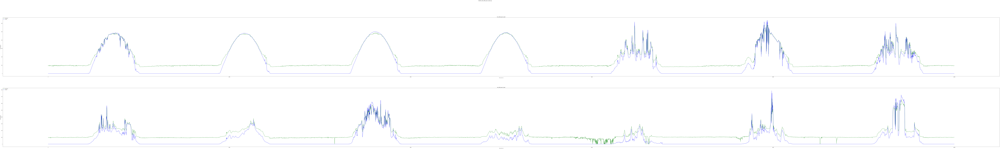

In [0]:
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt

# import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.wrappers.scikit_learn import KerasClassifier
from keras import optimizers
import keras.utils
import keras.layers

# Import Sklearn
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import AdaBoostClassifier

dir = '/content/drive/My Drive/Colab Notebooks/'

def read_irradiance_weather():
  # 1028982, 522720 in total
  # reads irradiance features
  print("\nReading Irradiance.csv...")
  irradiance = pd.read_csv(
      dir+"Irradiance.csv",
      delimiter=",",
      parse_dates=True,
      index_col=0,
  )
  # print('display(irradiance.head())')
  # display(irradiance.head())
  print("Reading Weather.csv...")
  weather= pd.read_csv(
      dir+"Weather.csv",
      delimiter=",",
      parse_dates=True,
      index_col=0,
  )
  # print('display(weather.head())')
  # display(weather.head())
  return irradiance, weather

def split_train_test(irradiance, weather, year_for_train=2015, year_for_test=2016):
  print("\nSpliting Train and Test Data Set...")
  train_data = irradiance[irradiance.index.year <= year_for_train]
  train_data = train_data.join(weather[weather.index.year <= year_for_train], how="inner")    
  test_data = irradiance[irradiance.index.year >= year_for_test]
  test_data = test_data.join(weather[weather.index.year >= year_for_test], how="inner")
  print("Train Data shape: ", train_data.shape)
  print("Test Data shape: ", test_data.shape)
  return train_data, test_data

def clear_data(train_data, test_data):
  print("\nClearing Data...")
  train_data = train_data.dropna(how="any")
  test_data = test_data.dropna(how="any")
  return train_data, test_data

def split_data_label(train_data, test_data, label_name='ghi'): 
  print('\nSpliting Labels...')
  train_label = train_data.loc[:,[label_name]].values
  test_label = test_data.loc[:,[label_name]].values
  # train_data = train_data.drop([label_name, 'dni', 'dhi'], axis=1).values
  # test_data = test_data.drop([label_name, 'dni', 'dhi'], axis=1).values
  # display(train_data)
  # display(test_data)
  print("Train Data shape: ", train_data.shape)
  print("Train Label shape: ", train_label.shape)
  print("Test Data shape: ", test_data.shape)
  print("Test Label shape: ", test_label.shape)
  return train_data, train_label, test_data, test_label

def get_batch(train_data, test_data, divided_parts=10, ith_part=1):
  print('\nGetting Batchs...')
  split_times = divided_parts
  ith = ith_part
  train_total = train_data.shape[0]
  test_total = test_data.shape[0]
  assert(train_total % 10 == 0)
  assert(test_total % 10 == 0)
  train_start = int((ith-1) * (train_total / split_times))
  train_end = int(ith * (train_total / split_times))
  test_start = int((ith-1) * (test_total / split_times))
  test_end = int(ith * (test_total / split_times))
  print('Train Start from ', train_start, ' to ', train_end)
  print('Train Test from ', test_start, ' to ', test_end)
  # train_selected_samples = 102890
  # test_selected_samples = 52270

  train_data = train_data[train_start:train_end, :]
  # train_label = train_label[train_start:train_end, :]
  test_data = test_data[test_start:test_end, :]
  # test_label = test_label[test_start:test_end, :]
  return train_data, test_data

def fold_time_steps(train_data, train_label, test_data, test_label, time_span, time_steps=10):
  print('\nFolding Time Steps by ', time_steps, ' ...')
  # The three dimensions of LSTM input are:
    # Samples. One sequence is one sample. A batch is comprised of one or more samples.
    # Time Steps. One time step is one point of observation in the sample.
    # Features. One feature is one observation at a time step.
  assert(train_data.shape[0] % time_steps == 0)
  train_l = train_data.shape[0]
  test_l = test_data.shape[0]
  data_features_num = train_data.shape[1]

  X_train = np.roll(train_data, -time_span, axis=0).reshape(train_l, 1, data_features_num)
  # print(train_data[0:10])
  X_test =  np.roll(test_data, -time_span, axis=0).reshape(test_l, 1, data_features_num)
  Y_train = np.roll(train_label, -time_span, axis=0).reshape(train_l, 1, 1)
  Y_test = np.roll(test_label, -time_span, axis=0).reshape(test_l, 1, 1)
  for i in range(1, time_steps):
    X_train = np.append(X_train, np.roll(train_data, -i-time_span, axis=0).reshape(train_l, 1, data_features_num), axis=1)
    Y_train = np.append(Y_train, np.roll(train_label, -i-time_span, axis=0).reshape(train_l, 1, 1), axis=1)
    X_test = np.append(X_test, np.roll(test_data, -i-time_span, axis=0).reshape(test_l, 1, data_features_num), axis=1)
    Y_test = np.append(Y_test, np.roll(test_label, -i-time_span, axis=0).reshape(test_l, 1, 1), axis=1)
  # print(X_train[0])
  X_train = X_train[:-time_steps-time_span]
  Y_train = Y_train[:-time_steps-time_span]
  X_test = X_test[:-time_steps-time_span]
  Y_test = Y_test[:-time_steps-time_span]

  print('X_train.shape: ', X_train.shape)
  print('X_test.shape: ', X_test.shape)  
  print('Y_train.shape: ', Y_train.shape)
  print('Y_test.shape: ', Y_test.shape)
  return X_train, Y_train, X_test, Y_test

def shift_time_span(train_data, train_label, test_data, test_label, time_span_later_mins=1):
  print('\nShifting Time Span by ', time_span_later_mins, ' ...')
  train_label = np.roll(train_label, -time_span_later_mins)
  test_label = np.roll(test_label, -time_span_later_mins)

  train_data = train_data[:-time_span_later_mins]
  train_label = train_label[:-time_span_later_mins]
  test_data = test_data[:-time_span_later_mins]
  test_label = test_label[:-time_span_later_mins]

  print('Train Data shape: ', train_data.shape)
  print('Train Label shape: ', train_label.shape)  
  print('Test Data shape: ', test_data.shape)
  print('Test Label shape: ', test_label.shape)

  return train_data, train_label, test_data, test_label

def normalize_data(train_data, test_data):
  print('\nNormalizing Data...')
  scaler = StandardScaler()
  scaler.fit(train_data)
  train_data = scaler.transform(train_data)
  test_data = scaler.transform(test_data)
  print('Train Data shape: ', train_data.shape)
  print('Test Data shape: ', train_data.shape)
  return train_data, test_data

def del_residual(train_data, train_label, test_data, test_label, mod=100):
  print('\nDeleting Residual...')
  if mod == 0:
    print('Mod == 0, Skip')
    return train_data, train_label, test_data, test_label
  
  train_length = train_data.shape[0]
  # print(train_length)
  test_length = test_data.shape[0]
  train_data_mod_length = train_length - (train_length % mod)
  test_data_mod_length = test_length - (test_length % mod)
  # print(train_data_mod_length)
  train_data = train_data[0:train_data_mod_length, :]
  train_label = train_label[:train_data_mod_length, :]
  test_data = test_data[:test_data_mod_length, :]
  test_label = test_label[:test_data_mod_length, :]

  print('Train Data shape: ', train_data.shape)
  print('Train Label shape: ', train_label.shape)  
  print('Test Data shape: ', test_data.shape)
  print('Test Label shape: ', test_label.shape)

  assert(train_data.shape[0] % mod == 0)
  assert(train_label.shape[0] % mod == 0)
  assert(test_data.shape[0] % mod == 0)
  assert(test_label.shape[0] % mod == 0)
  return train_data, train_label, test_data, test_label

#Construt and return Keras RNN model
def build_RNN(init_type = 'glorot_uniform', optimizer = 'adam', time_steps=10, num_features = 10):
    use_rnn = True
    model = Sequential()
    layers = [num_features, 64, 64, 1, 1]
    model.add(keras.layers.LSTM(
        layers[0],
        input_shape = (time_steps, num_features),
        return_sequences=True))
    model.add(keras.layers.Dropout(0.2))

    model.add(keras.layers.LSTM(
        layers[1],
        kernel_initializer = init_type,
        return_sequences=True
        #bias_initializer = 'zeros'
    ))
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[2], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    model.add(Dense(
        layers[3]))

    model.add(Activation("relu"))

    #Alternative parameters:
    #momentum = 0.8
    #learning_rate = 0.1
    #epochs = 100
    #decay_rate = learning_rate / 100
    #sgd = keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
    #model.compile(loss="binary_crossentropy", optimizer=sgd)
    rms = keras.optimizers.RMSprop(lr=0.002, rho=0.9, epsilon=1e-08, decay=0.01)
    model.compile(loss="mean_squared_error", optimizer=optimizer)

    return model

def build_ANN(init_type = 'glorot_uniform', optimizer = 'adam', time_steps=10, num_features = 10):
    use_ann = True
    model = Sequential()
    layers = [num_features, 64, 64, 1, 1]

    model.add(Dense(
        layers[0], activation='tanh',
        input_shape = (time_steps, num_features),
        kernel_initializer=init_type,
        
        ))
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[1], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[2], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    model.add(Dense(
        layers[3]))

    model.add(Activation("relu"))

    #Alternative parameters:
    #momentum = 0.8
    #learning_rate = 0.1
    #epochs = 100
    #decay_rate = learning_rate / 100
    #sgd = keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
    #model.compile(loss="binary_crossentropy", optimizer=sgd)
    rms = keras.optimizers.RMSprop(lr=0.002, rho=0.9, epsilon=1e-08, decay=0.01)
    model.compile(loss="mean_squared_error", optimizer=optimizer)

    return model
    
#Calculate NRMSE between two arrays of values
def nrmse(predicted, targets):
  return np.sqrt(((predicted - targets) ** 2).mean()) / np.mean(targets)
  # return np.sum(np.multiply((predicted - observed),(predicted - observed)))/predicted.shape[0]

def output_result(use_ann, use_rnn, time_span, time_step, trainset_predicted, Y_train, testset_predicted, Y_test, figsize_i=(300, 40), samples=10000):
  model = ''
  if use_ann == True:
    model = 'ANN'
  elif use_rnn == True:
    model = 'RNN'
  model_name = 'Weather_New_' + model + '_span' + str(time_span) + '_step' + str(time_step) + '.png'
  f = plt.figure(figsize=figsize_i)
  ax = f.add_subplot(211)
  ax2 = f.add_subplot(212)
  f.suptitle(model_name)

  train_name = 'train_' + model + '_span' + str(time_span) + '_step' + str(time_step)
  ax.plot(np.ravel(trainset_predicted[:samples, 0]), color='green', label='Predicted')
  ax.plot(np.ravel(Y_train[:samples, 0]), color='blue', label='Target')
  ax.set_title(train_name)
  ax.set_xlabel('Time unit: min')
  ax.set_ylabel('GHI Irradiance')
  ax.legend(loc='upper left')

  test_name = 'test_' + model + '_span' + str(time_span) + '_step' + str(time_step)
  ax2.plot(np.ravel(testset_predicted[:samples, 0]), color='green', label='Predicted')
  ax2.plot(np.ravel(Y_test[:samples, 0]), color='blue', label='Target')
  ax2.set_title(test_name)
  ax2.set_xlabel('Time unit: min')
  ax2.set_ylabel('GHI Irradiance')
  ax2.legend(loc='upper left')

  plt.savefig(dir+'result/' + model_name)
  plt.show()

def main(use_ann, use_rnn, time_span, time_step, mod, model_fit_epochs):
  # Parameters MODIFY HERE PLEASE
  # use_ann = True
  # use_rnn = False
  # time_span = 1
  # time_step = 5
  # mod = 100
  # model_fit_epochs = 1

  irradiance, weather = read_irradiance_weather()
  # np.savez_compressed(dir+'tmp/XY_TrainTest10_compressed6', X_train=X_train, Y_train=Y_train, X_test=X_test, Y_test=Y_test)
  # np.savez_compressed(dir+'tmp/Irradiance_Weather_compressed', Irradiance=irradiance.values, Weather=weather.values)
  # loaded = np.load(dir+'tmp/Irradiance_Weather_compressed.npz')
  # print(np.array_equal(irradiance.values, loaded['Irradiance']))
  # print(np.array_equal(weather.values, loaded['Weather']))
      
  #use 2015 for training set, 2016 for testing
  train_data, test_data = split_train_test(irradiance, weather, year_for_train=2015, year_for_test=2016)
  # train_data = train_data[0:20000]
  # test_data = test_data[0:20000]
  # Drop Invlid number
  train_data, test_data = clear_data(train_data, test_data)
  # Split Data and Label
  train_data, train_label, test_data, test_label = split_data_label(train_data, test_data, 'ghi')
  # normalize features
  train_data, test_data = normalize_data(train_data, test_data)
  # Shift Time Span
  train_data, train_label, test_data, test_label = shift_time_span(train_data, train_label, test_data, test_label, time_span_later_mins=time_span)
  # Reshape Data to Fit mod
  train_data, train_label, test_data, test_label = del_residual(train_data, train_label, test_data, test_label, mod)
  # Fold input data to 3D
  X_train, Y_train, X_test, Y_test = fold_time_steps(train_data, train_label, test_data, test_label, time_span, time_steps=time_step)

  print("\nX_train shape: ",X_train.shape, " Y_train shape: ",Y_train.shape)

  if use_ann == True and use_rnn==False:
    model = build_ANN('glorot_uniform', 'adam', time_steps=time_step, num_features=X_train.shape[2])
    print('\nUSE ANN Model\n')
  elif use_ann == False and use_rnn==True:
    model = build_RNN('glorot_uniform', 'adam', time_steps=time_step, num_features=X_train.shape[2])
    print('\nUSE RNN Model\n')
  else:
    print("Error: Please Choose only one Model")
    assert(use_ann == True and use_rnn==True)
    assert(use_ann == False and use_rnn==False)

  model.fit(X_train, Y_train, batch_size = 16, epochs = model_fit_epochs)

  trainset_predicted = model.predict(X_train)
  testset_predicted = model.predict(X_test)

  print("Train NRMSE: ", nrmse(trainset_predicted, Y_train))
  print("Test NRMSE: ", nrmse(testset_predicted, Y_test))

  output_result(use_ann, use_rnn, time_span, time_step, trainset_predicted, Y_train, testset_predicted, Y_test)

# ALL IN ONE
main(use_ann = True, use_rnn = False, time_span = 1, time_step = 5, mod = 100, model_fit_epochs = 5)
# main(use_ann = False, use_rnn = True, time_span = 1, time_step = 5, mod = 100, model_fit_epochs = 5)


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  5  ...
Train Data shape:  (1028977, 10)
Train Label shape:  (1028977, 1)
Test Data shape:  (522715, 10)
Test Label shape:  (522715, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028890, 5, 10)
X_test.shape:  (522690, 5, 10)
Y_train.shape:  (1028890, 5, 1)
Y_test.shape:  (522690, 5, 1)

X_train shape:  (1028890, 5, 10)  Y_train shape:  (1028890, 5, 1)

USE ANN Model

Epoch 1/5
1028890/1028890 [=====================

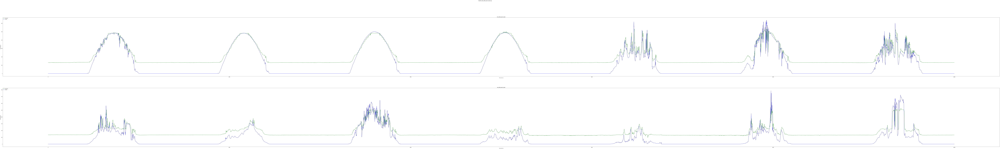

In [0]:
main(use_ann = True, use_rnn = False, time_span = 5, time_step = 5, mod = 100, model_fit_epochs = 5)
# main(use_ann = False, use_rnn = True, time_span = 5, time_step = 5, mod = 100, model_fit_epochs = 5)


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  15  ...
Train Data shape:  (1028967, 10)
Train Label shape:  (1028967, 1)
Test Data shape:  (522705, 10)
Test Label shape:  (522705, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028880, 5, 10)
X_test.shape:  (522680, 5, 10)
Y_train.shape:  (1028880, 5, 1)
Y_test.shape:  (522680, 5, 1)

X_train shape:  (1028880, 5, 10)  Y_train shape:  (1028880, 5, 1)

USE ANN Model

Epoch 1/5
1028880/1028880 [====================

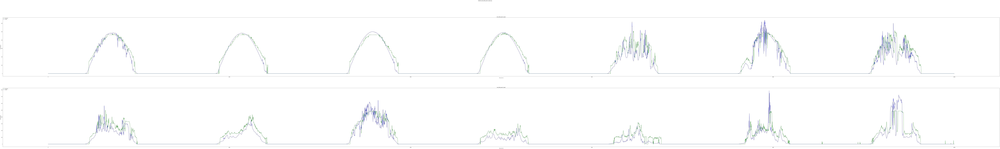

In [0]:
main(use_ann = True, use_rnn = False, time_span = 15, time_step = 5, mod = 100, model_fit_epochs = 5)
# main(use_ann = False, use_rnn = True, time_span = 15, time_step = 5, mod = 100, model_fit_epochs = 5)


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  60  ...
Train Data shape:  (1028922, 10)
Train Label shape:  (1028922, 1)
Test Data shape:  (522660, 10)
Test Label shape:  (522660, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522600, 10)
Test Label shape:  (522600, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028835, 5, 10)
X_test.shape:  (522535, 5, 10)
Y_train.shape:  (1028835, 5, 1)
Y_test.shape:  (522535, 5, 1)

X_train shape:  (1028835, 5, 10)  Y_train shape:  (1028835, 5, 1)

USE ANN Model

Epoch 1/5
1028835/1028835 [====================

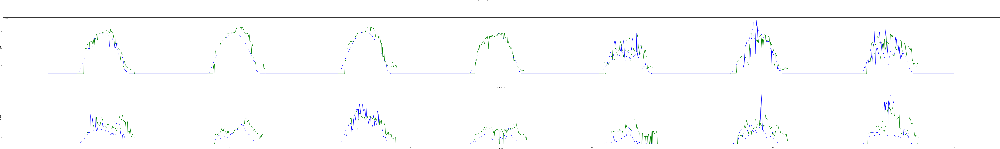

In [0]:
main(use_ann = True, use_rnn = False, time_span = 60, time_step = 5, mod = 100, model_fit_epochs = 5)
# main(use_ann = False, use_rnn = True, time_span = 60, time_step = 5, mod = 100, model_fit_epochs = 5)

In [0]:
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt

# import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.wrappers.scikit_learn import KerasClassifier
from keras import optimizers
import keras.utils
import keras.layers

# Import Sklearn
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import AdaBoostClassifier

dir = '/content/drive/My Drive/Colab Notebooks/'

def read_irradiance_weather():
  # 1028982, 522720 in total
  # reads irradiance features
  print("\nReading Irradiance.csv...")
  irradiance = pd.read_csv(
      dir+"Irradiance.csv",
      delimiter=",",
      parse_dates=True,
      index_col=0,
  )
  # print('display(irradiance.head())')
  # display(irradiance.head())
  print("Reading Weather.csv...")
  weather= pd.read_csv(
      dir+"Weather.csv",
      delimiter=",",
      parse_dates=True,
      index_col=0,
  )
  # print('display(weather.head())')
  # display(weather.head())
  return irradiance, weather

def split_train_test(irradiance, weather, year_for_train=2015, year_for_test=2016):
  print("\nSpliting Train and Test Data Set...")
  train_data = irradiance[irradiance.index.year <= year_for_train]
  train_data = train_data.join(weather[weather.index.year <= year_for_train], how="inner")    
  test_data = irradiance[irradiance.index.year >= year_for_test]
  test_data = test_data.join(weather[weather.index.year >= year_for_test], how="inner")
  print("Train Data shape: ", train_data.shape)
  print("Test Data shape: ", test_data.shape)
  return train_data, test_data

def clear_data(train_data, test_data):
  print("\nClearing Data...")
  train_data = train_data.dropna(how="any")
  test_data = test_data.dropna(how="any")
  return train_data, test_data

def split_data_label(train_data, test_data, label_name='ghi'): 
  print('\nSpliting Labels...')
  train_label = train_data.loc[:,[label_name]].values
  test_label = test_data.loc[:,[label_name]].values
  # train_data = train_data.drop([label_name, 'dni', 'dhi'], axis=1).values
  # test_data = test_data.drop([label_name, 'dni', 'dhi'], axis=1).values
  # display(train_data)
  # display(test_data)
  print("Train Data shape: ", train_data.shape)
  print("Train Label shape: ", train_label.shape)
  print("Test Data shape: ", test_data.shape)
  print("Test Label shape: ", test_label.shape)
  return train_data, train_label, test_data, test_label

def get_batch(train_data, test_data, divided_parts=10, ith_part=1):
  print('\nGetting Batchs...')
  split_times = divided_parts
  ith = ith_part
  train_total = train_data.shape[0]
  test_total = test_data.shape[0]
  assert(train_total % 10 == 0)
  assert(test_total % 10 == 0)
  train_start = int((ith-1) * (train_total / split_times))
  train_end = int(ith * (train_total / split_times))
  test_start = int((ith-1) * (test_total / split_times))
  test_end = int(ith * (test_total / split_times))
  print('Train Start from ', train_start, ' to ', train_end)
  print('Train Test from ', test_start, ' to ', test_end)
  # train_selected_samples = 102890
  # test_selected_samples = 52270

  train_data = train_data[train_start:train_end, :]
  # train_label = train_label[train_start:train_end, :]
  test_data = test_data[test_start:test_end, :]
  # test_label = test_label[test_start:test_end, :]
  return train_data, test_data

def fold_time_steps(train_data, train_label, test_data, test_label, time_span, time_steps=10):
  print('\nFolding Time Steps by ', time_steps, ' ...')
  # The three dimensions of LSTM input are:
    # Samples. One sequence is one sample. A batch is comprised of one or more samples.
    # Time Steps. One time step is one point of observation in the sample.
    # Features. One feature is one observation at a time step.
  assert(train_data.shape[0] % time_steps == 0)
  train_l = train_data.shape[0]
  test_l = test_data.shape[0]
  data_features_num = train_data.shape[1]

  X_train = np.roll(train_data, -time_span, axis=0).reshape(train_l, 1, data_features_num)
  # print(train_data[0:10])
  X_test =  np.roll(test_data, -time_span, axis=0).reshape(test_l, 1, data_features_num)
  Y_train = np.roll(train_label, -time_span, axis=0).reshape(train_l, 1, 1)
  Y_test = np.roll(test_label, -time_span, axis=0).reshape(test_l, 1, 1)
  for i in range(1, time_steps):
    X_train = np.append(X_train, np.roll(train_data, -i-time_span, axis=0).reshape(train_l, 1, data_features_num), axis=1)
    Y_train = np.append(Y_train, np.roll(train_label, -i-time_span, axis=0).reshape(train_l, 1, 1), axis=1)
    X_test = np.append(X_test, np.roll(test_data, -i-time_span, axis=0).reshape(test_l, 1, data_features_num), axis=1)
    Y_test = np.append(Y_test, np.roll(test_label, -i-time_span, axis=0).reshape(test_l, 1, 1), axis=1)
  # print(X_train[0])
  X_train = X_train[:-time_steps-time_span]
  Y_train = Y_train[:-time_steps-time_span]
  X_test = X_test[:-time_steps-time_span]
  Y_test = Y_test[:-time_steps-time_span]

  print('X_train.shape: ', X_train.shape)
  print('X_test.shape: ', X_test.shape)  
  print('Y_train.shape: ', Y_train.shape)
  print('Y_test.shape: ', Y_test.shape)
  return X_train, Y_train, X_test, Y_test

def shift_time_span(train_data, train_label, test_data, test_label, time_span_later_mins=1):
  print('\nShifting Time Span by ', time_span_later_mins, ' ...')
  train_label = np.roll(train_label, -time_span_later_mins)
  test_label = np.roll(test_label, -time_span_later_mins)

  train_data = train_data[:-time_span_later_mins]
  train_label = train_label[:-time_span_later_mins]
  test_data = test_data[:-time_span_later_mins]
  test_label = test_label[:-time_span_later_mins]

  print('Train Data shape: ', train_data.shape)
  print('Train Label shape: ', train_label.shape)  
  print('Test Data shape: ', test_data.shape)
  print('Test Label shape: ', test_label.shape)

  return train_data, train_label, test_data, test_label

def normalize_data(train_data, test_data):
  print('\nNormalizing Data...')
  scaler = StandardScaler()
  scaler.fit(train_data)
  train_data = scaler.transform(train_data)
  test_data = scaler.transform(test_data)
  print('Train Data shape: ', train_data.shape)
  print('Test Data shape: ', train_data.shape)
  return train_data, test_data

def del_residual(train_data, train_label, test_data, test_label, mod=100):
  print('\nDeleting Residual...')
  if mod == 0:
    print('Mod == 0, Skip')
    return train_data, train_label, test_data, test_label
  
  train_length = train_data.shape[0]
  # print(train_length)
  test_length = test_data.shape[0]
  train_data_mod_length = train_length - (train_length % mod)
  test_data_mod_length = test_length - (test_length % mod)
  # print(train_data_mod_length)
  train_data = train_data[0:train_data_mod_length, :]
  train_label = train_label[:train_data_mod_length, :]
  test_data = test_data[:test_data_mod_length, :]
  test_label = test_label[:test_data_mod_length, :]

  print('Train Data shape: ', train_data.shape)
  print('Train Label shape: ', train_label.shape)  
  print('Test Data shape: ', test_data.shape)
  print('Test Label shape: ', test_label.shape)

  assert(train_data.shape[0] % mod == 0)
  assert(train_label.shape[0] % mod == 0)
  assert(test_data.shape[0] % mod == 0)
  assert(test_label.shape[0] % mod == 0)
  return train_data, train_label, test_data, test_label

#Construt and return Keras RNN model
def build_RNN(init_type = 'glorot_uniform', optimizer = 'adam', time_steps=10, num_features = 10):
    use_rnn = True
    model = Sequential()
    layers = [num_features, 64, 64, 1, 1]
    model.add(keras.layers.LSTM(
        layers[0],
        input_shape = (time_steps, num_features),
        return_sequences=True))
    model.add(keras.layers.Dropout(0.2))

    model.add(keras.layers.LSTM(
        layers[1],
        kernel_initializer = init_type,
        return_sequences=True
        #bias_initializer = 'zeros'
    ))
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[2], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    model.add(Dense(
        layers[3]))

    model.add(Activation("relu"))

    #Alternative parameters:
    #momentum = 0.8
    #learning_rate = 0.1
    #epochs = 100
    #decay_rate = learning_rate / 100
    #sgd = keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
    #model.compile(loss="binary_crossentropy", optimizer=sgd)
    rms = keras.optimizers.RMSprop(lr=0.002, rho=0.9, epsilon=1e-08, decay=0.01)
    model.compile(loss="mean_squared_error", optimizer=optimizer)

    return model

def build_ANN(init_type = 'glorot_uniform', optimizer = 'adam', time_steps=10, num_features = 10):
    use_ann = True
    model = Sequential()
    layers = [num_features, 64, 64, 1, 1]

    model.add(Dense(
        layers[0], activation='tanh',
        input_shape = (time_steps, num_features),
        kernel_initializer=init_type,
        
        ))
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[1], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[2], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    model.add(Dense(
        layers[3]))

    model.add(Activation("relu"))

    #Alternative parameters:
    #momentum = 0.8
    #learning_rate = 0.1
    #epochs = 100
    #decay_rate = learning_rate / 100
    #sgd = keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
    #model.compile(loss="binary_crossentropy", optimizer=sgd)
    rms = keras.optimizers.RMSprop(lr=0.002, rho=0.9, epsilon=1e-08, decay=0.01)
    model.compile(loss="mean_squared_error", optimizer=optimizer)

    return model
    
#Calculate NRMSE between two arrays of values
def nrmse(predicted, targets):
  return np.sqrt(((predicted - targets) ** 2).mean()) / np.mean(targets)
  # return np.sum(np.multiply((predicted - observed),(predicted - observed)))/predicted.shape[0]

def output_result(use_ann, use_rnn, time_span, time_step, trainset_predicted, Y_train, testset_predicted, Y_test, figsize_i=(300, 40), samples=10000):
  model = ''
  if use_ann == True:
    model = 'ANN'
  elif use_rnn == True:
    model = 'RNN'
  model_name = 'Weather_New_' + model + '_span' + str(time_span) + '_step' + str(time_step) + '.png'
  f = plt.figure(figsize=figsize_i)
  ax = f.add_subplot(211)
  ax2 = f.add_subplot(212)
  f.suptitle(model_name)

  train_name = 'train_' + model + '_span' + str(time_span) + '_step' + str(time_step)
  ax.plot(np.ravel(trainset_predicted[:samples, 0]), color='green', label='Predicted')
  ax.plot(np.ravel(Y_train[:samples, 0]), color='blue', label='Target')
  ax.set_title(train_name)
  ax.set_xlabel('Time unit: min')
  ax.set_ylabel('GHI Irradiance')
  ax.legend(loc='upper left')

  test_name = 'test_' + model + '_span' + str(time_span) + '_step' + str(time_step)
  ax2.plot(np.ravel(testset_predicted[:samples, 0]), color='green', label='Predicted')
  ax2.plot(np.ravel(Y_test[:samples, 0]), color='blue', label='Target')
  ax2.set_title(test_name)
  ax2.set_xlabel('Time unit: min')
  ax2.set_ylabel('GHI Irradiance')
  ax2.legend(loc='upper left')

  plt.savefig(dir+'result/' + model_name)
  plt.show()

def main(use_ann, use_rnn, time_span, time_step, mod, model_fit_epochs):
  # Parameters MODIFY HERE PLEASE
  # use_ann = True
  # use_rnn = False
  # time_span = 1
  # time_step = 5
  # mod = 100
  # model_fit_epochs = 1

  irradiance, weather = read_irradiance_weather()
  # np.savez_compressed(dir+'tmp/XY_TrainTest10_compressed6', X_train=X_train, Y_train=Y_train, X_test=X_test, Y_test=Y_test)
  # np.savez_compressed(dir+'tmp/Irradiance_Weather_compressed', Irradiance=irradiance.values, Weather=weather.values)
  # loaded = np.load(dir+'tmp/Irradiance_Weather_compressed.npz')
  # print(np.array_equal(irradiance.values, loaded['Irradiance']))
  # print(np.array_equal(weather.values, loaded['Weather']))
      
  #use 2015 for training set, 2016 for testing
  train_data, test_data = split_train_test(irradiance, weather, year_for_train=2015, year_for_test=2016)
  # train_data = train_data[0:20000]
  # test_data = test_data[0:20000]
  # Drop Invlid number
  train_data, test_data = clear_data(train_data, test_data)
  # Split Data and Label
  train_data, train_label, test_data, test_label = split_data_label(train_data, test_data, 'ghi')
  # normalize features
  train_data, test_data = normalize_data(train_data, test_data)
  # Shift Time Span
  train_data, train_label, test_data, test_label = shift_time_span(train_data, train_label, test_data, test_label, time_span_later_mins=time_span)
  # Reshape Data to Fit mod
  train_data, train_label, test_data, test_label = del_residual(train_data, train_label, test_data, test_label, mod)
  # Fold input data to 3D
  X_train, Y_train, X_test, Y_test = fold_time_steps(train_data, train_label, test_data, test_label, time_span, time_steps=time_step)

  print("\nX_train shape: ",X_train.shape, " Y_train shape: ",Y_train.shape)

  if use_ann == True and use_rnn==False:
    model = build_ANN('glorot_uniform', 'adam', time_steps=time_step, num_features=X_train.shape[2])
    print('\nUSE ANN Model\n')
  elif use_ann == False and use_rnn==True:
    model = build_RNN('glorot_uniform', 'adam', time_steps=time_step, num_features=X_train.shape[2])
    print('\nUSE RNN Model\n')
  else:
    print("Error: Please Choose only one Model")
    assert(use_ann == True and use_rnn==True)
    assert(use_ann == False and use_rnn==False)
  print('Predict ', time_span, ' mins')

  model.fit(X_train, Y_train, batch_size = 16, epochs = model_fit_epochs)

  trainset_predicted = model.predict(X_train)
  testset_predicted = model.predict(X_test)

  print("Train NRMSE: ", nrmse(trainset_predicted, Y_train))
  print("Test NRMSE: ", nrmse(testset_predicted, Y_test))

  output_result(use_ann, use_rnn, time_span, time_step, trainset_predicted, Y_train, testset_predicted, Y_test)

# ALL IN ONE
# main(use_ann = True, use_rnn = False, time_span = 1, time_step = 5, mod = 100, model_fit_epochs = 5)
# main(use_ann = False, use_rnn = True, time_span = 1, time_step = 5, mod = 100, model_fit_epochs = 5)
span_array = [1, 5, 15, 60]
# for sel_span in span_array:
  # main(use_ann = False, use_rnn = True, time_span = sel_span, time_step = 5, mod = 100, model_fit_epochs = 5)

Using TensorFlow backend.



Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  1  ...
Train Data shape:  (1028981, 10)
Train Label shape:  (1028981, 1)
Test Data shape:  (522719, 10)
Test Label shape:  (522719, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028894, 5, 10)
X_test.shape:  (522694, 5, 10)
Y_train.shape:  (1028894, 5, 1)
Y_test.shape:  (522694, 5, 1)

X_train shape:  (1028894, 5, 10)  Y_train shape:  (1028894, 5, 1)




Instructions for updating:
Please use `rate` instead of `kee

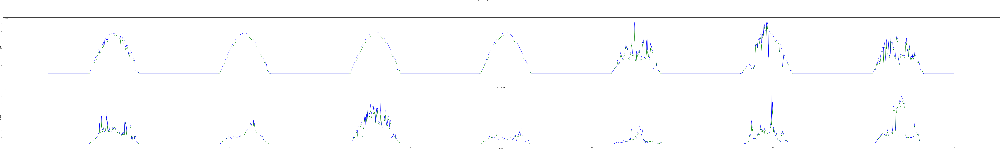

In [0]:
main(use_ann = False, use_rnn = True, time_span = 1, time_step = 5, mod = 100, model_fit_epochs = 5)

In [0]:
main(use_ann = False, use_rnn = True, time_span = 5, time_step = 5, mod = 100, model_fit_epochs = 5)


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  15  ...
Train Data shape:  (1028967, 10)
Train Label shape:  (1028967, 1)
Test Data shape:  (522705, 10)
Test Label shape:  (522705, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028880, 5, 10)
X_test.shape:  (522680, 5, 10)
Y_train.shape:  (1028880, 5, 1)
Y_test.shape:  (522680, 5, 1)

X_train shape:  (1028880, 5, 10)  Y_train shape:  (1028880, 5, 1)

USE RNN Model

Predict  15  mins
Epoch 1/5
1028880/1028880 [==

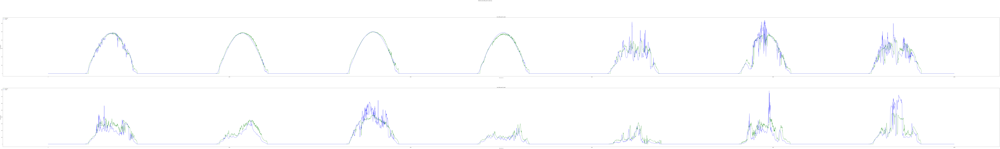

In [0]:
main(use_ann = False, use_rnn = True, time_span = 15, time_step = 5, mod = 100, model_fit_epochs = 5)


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  60  ...
Train Data shape:  (1028922, 10)
Train Label shape:  (1028922, 1)
Test Data shape:  (522660, 10)
Test Label shape:  (522660, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522600, 10)
Test Label shape:  (522600, 1)

Folding Time Steps by  5  ...
X_train.shape:  (1028835, 5, 10)
X_test.shape:  (522535, 5, 10)
Y_train.shape:  (1028835, 5, 1)
Y_test.shape:  (522535, 5, 1)

X_train shape:  (1028835, 5, 10)  Y_train shape:  (1028835, 5, 1)

USE RNN Model

Predict  60  mins
Epoch 1/5
1028835/1028835 [==

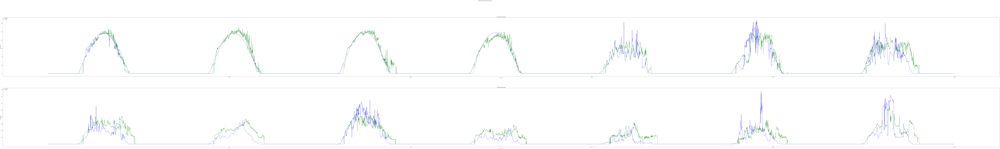

In [0]:
main(use_ann = False, use_rnn = True, time_span = 60, time_step = 5, mod = 100, model_fit_epochs = 5)


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  1  ...
Train Data shape:  (1028981, 10)
Train Label shape:  (1028981, 1)
Test Data shape:  (522719, 10)
Test Label shape:  (522719, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

USE Linear Model


X_train shape:  (1028900, 10)  Y_train shape:  (1028900,)
1min Train NRMSE:  0.12483513463788173
1min Test NRMSE:  0.1283986485882084


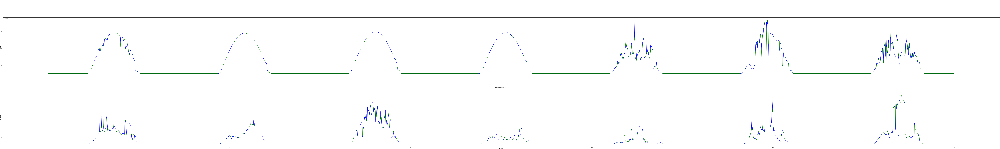


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  5  ...
Train Data shape:  (1028977, 10)
Train Label shape:  (1028977, 1)
Test Data shape:  (522715, 10)
Test Label shape:  (522715, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

USE Linear Model


X_train shape:  (1028900, 10)  Y_train shape:  (1028900,)
5min Train NRMSE:  0.23853408475740712
5min Test NRMSE:  0.24033560928762593


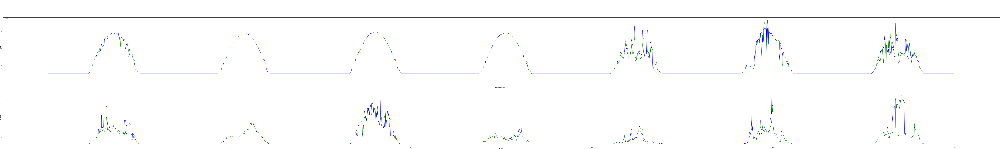


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  15  ...
Train Data shape:  (1028967, 10)
Train Label shape:  (1028967, 1)
Test Data shape:  (522705, 10)
Test Label shape:  (522705, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522700, 10)
Test Label shape:  (522700, 1)

USE Linear Model


X_train shape:  (1028900, 10)  Y_train shape:  (1028900,)
15min Train NRMSE:  0.3070442166209835
15min Test NRMSE:  0.30679470688560173


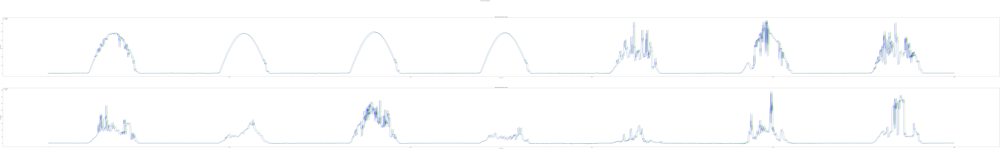


Reading Irradiance.csv...
Reading Weather.csv...

Spliting Train and Test Data Set...
Train Data shape:  (1029600, 10)
Test Data shape:  (522720, 10)

Clearing Data...

Spliting Labels...
Train Data shape:  (1028982, 10)
Train Label shape:  (1028982, 1)
Test Data shape:  (522720, 10)
Test Label shape:  (522720, 1)

Normalizing Data...
Train Data shape:  (1028982, 10)
Test Data shape:  (1028982, 10)

Shifting Time Span by  60  ...
Train Data shape:  (1028922, 10)
Train Label shape:  (1028922, 1)
Test Data shape:  (522660, 10)
Test Label shape:  (522660, 1)

Deleting Residual...
Train Data shape:  (1028900, 10)
Train Label shape:  (1028900, 1)
Test Data shape:  (522600, 10)
Test Label shape:  (522600, 1)

USE Linear Model


X_train shape:  (1028900, 10)  Y_train shape:  (1028900,)
60min Train NRMSE:  0.5022938651437105
60min Test NRMSE:  0.5126452159200944


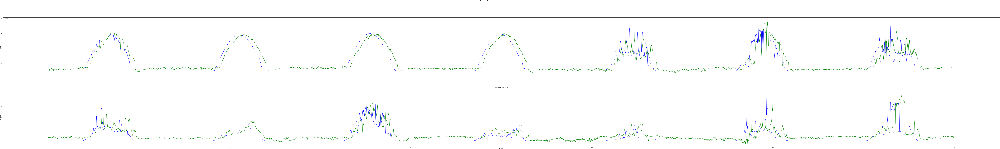

In [0]:
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt

# import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.wrappers.scikit_learn import KerasClassifier
from keras import optimizers
import keras.utils
import keras.layers

# Import Sklearn
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import AdaBoostClassifier
from sklearn import linear_model, ensemble, neural_network

dir = '/content/drive/My Drive/Colab Notebooks/'

def read_irradiance_weather():
  # 1028982, 522720 in total
  # reads irradiance features
  print("\nReading Irradiance.csv...")
  irradiance = pd.read_csv(
      dir+"Irradiance.csv",
      delimiter=",",
      parse_dates=True,
      index_col=0,
  )
  # print('display(irradiance.head())')
  # display(irradiance.head())
  print("Reading Weather.csv...")
  weather= pd.read_csv(
      dir+"Weather.csv",
      delimiter=",",
      parse_dates=True,
      index_col=0,
  )
  # print('display(weather.head())')
  # display(weather.head())
  
  return irradiance, weather 

def split_train_test(irradiance, weather, year_for_train=2015, year_for_test=2016):
  print("\nSpliting Train and Test Data Set...")
  train_data = irradiance[irradiance.index.year <= year_for_train]
  train_data = train_data.join(weather[weather.index.year <= year_for_train], how="inner")    
  test_data = irradiance[irradiance.index.year >= year_for_test]
  test_data = test_data.join(weather[weather.index.year >= year_for_test], how="inner")
  print("Train Data shape: ", train_data.shape)
  print("Test Data shape: ", test_data.shape)
  return train_data, test_data

def clear_data(train_data, test_data):
  print("\nClearing Data...")
  train_data = train_data.dropna(how="any")
  test_data = test_data.dropna(how="any")
  return train_data, test_data

def split_data_label(train_data, test_data, label_name='ghi'): 
  print('\nSpliting Labels...')
  train_label = train_data.loc[:,[label_name]].values
  test_label = test_data.loc[:,[label_name]].values
  # train_data = train_data.drop([label_name, 'dni', 'dhi'], axis=1).values
  # test_data = test_data.drop([label_name, 'dni', 'dhi'], axis=1).values
  # display(train_data)
  # display(test_data)
  print("Train Data shape: ", train_data.shape)
  print("Train Label shape: ", train_label.shape)
  print("Test Data shape: ", test_data.shape)
  print("Test Label shape: ", test_label.shape)
  return train_data, train_label, test_data, test_label

def get_batch(train_data, test_data, divided_parts=10, ith_part=1):
  print('\nGetting Batchs...')
  split_times = divided_parts
  ith = ith_part
  train_total = train_data.shape[0]
  test_total = test_data.shape[0]
  assert(train_total % 10 == 0)
  assert(test_total % 10 == 0)
  train_start = int((ith-1) * (train_total / split_times))
  train_end = int(ith * (train_total / split_times))
  test_start = int((ith-1) * (test_total / split_times))
  test_end = int(ith * (test_total / split_times))
  print('Train Start from ', train_start, ' to ', train_end)
  print('Train Test from ', test_start, ' to ', test_end)
  # train_selected_samples = 102890
  # test_selected_samples = 52270

  train_data = train_data[train_start:train_end, :]
  # train_label = train_label[train_start:train_end, :]
  test_data = test_data[test_start:test_end, :]
  # test_label = test_label[test_start:test_end, :]
  return train_data, test_data

def fold_time_steps(train_data, train_label, test_data, test_label, time_steps=10):
  print('\nFolding Time Steps by ', time_steps, ' ...')
  # The three dimensions of LSTM input are:
    # Samples. One sequence is one sample. A batch is comprised of one or more samples.
    # Time Steps. One time step is one point of observation in the sample.
    # Features. One feature is one observation at a time step.
  print('\nFolding Time Steps by ', time_steps, ' ...')
  # The three dimensions of LSTM input are:
    # Samples. One sequence is one sample. A batch is comprised of one or more samples.
    # Time Steps. One time step is one point of observation in the sample.
    # Features. One feature is one observation at a time step.
  assert(train_data.shape[0] % time_steps == 0)
  train_l = train_data.shape[0]
  test_l = test_data.shape[0]
  data_features_num = train_data.shape[1]

  X_train = train_data.reshape(train_l, 1, data_features_num)
  X_test =  test_data.reshape(test_l, 1, data_features_num)
  Y_train = train_label.reshape(train_l, 1, 1)
  Y_test = test_label.reshape(test_l, 1, 1)
  for i in range(1, time_steps):
    X_train = np.append(X_train, np.roll(train_data, -i-time_span, axis=0).reshape(train_l, 1, data_features_num), axis=1)
    Y_train = np.append(Y_train, np.roll(train_label, -i-time_span, axis=0).reshape(train_l, 1, 1), axis=1)
    X_test = np.append(X_test, np.roll(test_data, -i-time_span, axis=0).reshape(test_l, 1, data_features_num), axis=1)
    Y_test = np.append(Y_test, np.roll(test_label, -i-time_span, axis=0).reshape(test_l, 1, 1), axis=1)
  X_train = X_train[:-time_steps-time_span]
  Y_train = Y_train[:-time_steps-time_span]
  X_test = X_test[:-time_steps-time_span]
  Y_test = Y_test[:-time_steps-time_span]

  print('X_train.shape: ', X_train.shape)
  print('X_test.shape: ', X_test.shape)  
  print('Y_train.shape: ', Y_train.shape)
  print('Y_test.shape: ', Y_test.shape)
  
  return X_train, Y_train, X_test, Y_test

def shift_time_span(train_data, train_label, test_data, test_label, time_span_later_mins=1):
  print('\nShifting Time Span by ', time_span_later_mins, ' ...')
  train_label = np.roll(train_label, -time_span_later_mins)
  test_label = np.roll(test_label, -time_span_later_mins)

  train_data = train_data[:-time_span_later_mins]
  train_label = train_label[:-time_span_later_mins]
  test_data = test_data[:-time_span_later_mins]
  test_label = test_label[:-time_span_later_mins]

  print('Train Data shape: ', train_data.shape)
  print('Train Label shape: ', train_label.shape)  
  print('Test Data shape: ', test_data.shape)
  print('Test Label shape: ', test_label.shape)

  return train_data, train_label, test_data, test_label

def normalize_data(train_data, test_data):
  print('\nNormalizing Data...')
  scaler = StandardScaler()
  scaler.fit(train_data)
  train_data = scaler.transform(train_data)
  test_data = scaler.transform(test_data)
  print('Train Data shape: ', train_data.shape)
  print('Test Data shape: ', train_data.shape)
  return train_data, test_data

def del_residual(train_data, train_label, test_data, test_label, mod=100):
  print('\nDeleting Residual...')
  if mod == 0:
    print('Mod == 0, Skip')
    return train_data, train_label, test_data, test_label
  
  train_length = train_data.shape[0]
  # print(train_length)
  test_length = test_data.shape[0]
  train_data_mod_length = train_length - (train_length % mod)
  test_data_mod_length = test_length - (test_length % mod)
  # print(train_data_mod_length)
  train_data = train_data[0:train_data_mod_length, :]
  train_label = train_label[:train_data_mod_length, :]
  test_data = test_data[:test_data_mod_length, :]
  test_label = test_label[:test_data_mod_length, :]

  print('Train Data shape: ', train_data.shape)
  print('Train Label shape: ', train_label.shape)  
  print('Test Data shape: ', test_data.shape)
  print('Test Label shape: ', test_label.shape)

  assert(train_data.shape[0] % mod == 0)
  assert(train_label.shape[0] % mod == 0)
  assert(test_data.shape[0] % mod == 0)
  assert(test_label.shape[0] % mod == 0)
  return train_data, train_label, test_data, test_label

#Construt and return Keras RNN model
def build_RNN(init_type = 'glorot_uniform', optimizer = 'adam', time_steps=10, num_features = 10):
    use_rnn = True
    model = Sequential()
    layers = [num_features, 64, 64, 1, 1]
    model.add(keras.layers.LSTM(
        layers[0],
        input_shape = (time_steps, num_features),
        return_sequences=True))
    model.add(keras.layers.Dropout(0.2))

    model.add(keras.layers.LSTM(
        layers[1],
        kernel_initializer = init_type,
        return_sequences=True
        #bias_initializer = 'zeros'
    ))
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[2], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    model.add(Dense(
        layers[3]))

    model.add(Activation("relu"))

    #Alternative parameters:
    #momentum = 0.8
    #learning_rate = 0.1
    #epochs = 100
    #decay_rate = learning_rate / 100
    #sgd = keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
    #model.compile(loss="binary_crossentropy", optimizer=sgd)
    rms = keras.optimizers.RMSprop(lr=0.002, rho=0.9, epsilon=1e-08, decay=0.01)
    model.compile(loss="mean_squared_error", optimizer=optimizer)

    return model

def build_ANN(init_type = 'glorot_uniform', optimizer = 'adam', time_steps=10, num_features = 10):
    use_ann = True
    model = Sequential()
    layers = [num_features, 64, 64, 1, 1]

    model.add(Dense(
        layers[0], activation='tanh',
        input_shape = (time_steps, num_features),
        kernel_initializer=init_type,
        ))
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[1], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    
    model.add(keras.layers.Dropout(0.2))

    model.add(Dense(
        layers[2], activation='tanh',
        kernel_initializer=init_type,
        input_shape = (None, 1)
        ))
    model.add(Dense(
        layers[3]))

    model.add(Activation("relu"))

    #Alternative parameters:
    #momentum = 0.8
    #learning_rate = 0.1
    #epochs = 100
    #decay_rate = learning_rate / 100
    #sgd = keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
    #model.compile(loss="binary_crossentropy", optimizer=sgd)
    rms = keras.optimizers.RMSprop(lr=0.002, rho=0.9, epsilon=1e-08, decay=0.01)
    model.compile(loss="mean_squared_error", optimizer=optimizer)

    return model

    
#Calculate NRMSE between two arrays of values
def nrmse(predicted, targets):
  return np.sqrt(((predicted - targets) ** 2).mean()) / np.mean(targets)
  # return np.sum(np.multiply((predicted - observed),(predicted - observed)))/predicted.shape[0]

def output_result(model, time_span, time_step, trainset_predicted, Y_train, testset_predicted, Y_test, figsize_i=(300, 40), samples=10000):

  model_name = model + '_span' + str(time_span) + '_step' + str(time_step) + '.png'
  f = plt.figure(figsize=figsize_i)
  ax = f.add_subplot(211)
  ax2 = f.add_subplot(212)
  f.suptitle(model_name)

  train_name = 'Weather_New' + model + '_span' + str(time_span) + '_step' + str(time_step)
  if model=='linear':
    ax.plot(trainset_predicted[:samples], color='green', label='Predicted')
    ax.plot(Y_train[:samples], color='blue', label='Target')
  else:
    ax.plot(np.ravel(trainset_predicted[:samples, 0]), color='green', label='Predicted')
    ax.plot(np.ravel(Y_train[:samples, 0]), color='blue', label='Target')
  ax.set_title(train_name)
  ax.set_xlabel('Time unit: min')
  ax.set_ylabel('GHI Irradiance')
  ax.legend(loc='upper left')

  test_name = 'Weather_New' + model + '_span' + str(time_span) + '_step' + str(time_step)
  if model=='linear':
    ax2.plot(testset_predicted[:samples], color='green', label='Predicted')
    ax2.plot(Y_test[:samples], color='blue', label='Target')
  else:
    ax2.plot(np.ravel(testset_predicted[:samples, 0]), color='green', label='Predicted')
    ax2.plot(np.ravel(Y_test[:samples, 0]), color='blue', label='Target')
  ax2.set_title(test_name)
  ax2.set_xlabel('Time unit: min')
  ax2.set_ylabel('GHI Irradiance')
  ax2.legend(loc='upper left')

  plt.savefig(dir+'result/' + model_name)
  plt.show()

def main(model_name, time_span, time_step, mod, model_fit_epochs):
  # Parameters MODIFY HERE PLEASE
  # use_ann = True
  # use_rnn = False
  # time_span = 1
  # time_step = 5
  # mod = 100
  # model_fit_epochs = 1

  irradiance, weather = read_irradiance_weather()
  # np.savez_compressed(dir+'tmp/XY_TrainTest10_compressed6', X_train=X_train, Y_train=Y_train, X_test=X_test, Y_test=Y_test)
  # np.savez_compressed(dir+'tmp/Irradiance_Weather_compressed', Irradiance=irradiance.values, Weather=weather.values)
  # loaded = np.load(dir+'tmp/Irradiance_Weather_compressed.npz')
  # print(np.array_equal(irradiance.values, loaded['Irradiance']))
  # print(np.array_equal(weather.values, loaded['Weather']))
      
  #use 2015 for training set, 2016 for testing
  train_data, test_data = split_train_test(irradiance, weather, year_for_train=2015, year_for_test=2016)
  # train_data = train_data[0:20000]
  # test_data = test_data[0:20000]
  # Drop Invlid number
  train_data, test_data = clear_data(train_data, test_data)
  # Split Data and Label
  train_data, train_label, test_data, test_label = split_data_label(train_data, test_data, 'ghi')
  # normalize features
  train_data, test_data = normalize_data(train_data, test_data)
  # Shift Time Span
  train_data, train_label, test_data, test_label = shift_time_span(train_data, train_label, test_data, test_label, time_span_later_mins=time_span)
  # Reshape Data to Fit mod
  train_data, train_label, test_data, test_label = del_residual(train_data, train_label, test_data, test_label, mod)
 

  if model_name=='ann':
    # Fold input data to 3D
    X_train, Y_train, X_test, Y_test = fold_time_steps(train_data, train_label, test_data, test_label, time_steps=time_step)
    model = build_ANN('glorot_uniform', 'adam', time_steps=time_step, num_features=X_train.shape[2])
    model.fit(X_train, Y_train, batch_size = 16, epochs = model_fit_epochs)
    print('\nUSE ANN Model\n')
  elif model_name=='rnn':
    # Fold input data to 3D
    X_train, Y_train, X_test, Y_test = fold_time_steps(train_data, train_label, test_data, test_label, time_steps=time_step)
    model = build_RNN('glorot_uniform', 'adam', time_steps=time_step, num_features=X_train.shape[2])
    model.fit(X_train, Y_train, batch_size = 16, epochs = model_fit_epochs)
    print('\nUSE RNN Model\n')
  elif model_name=='linear':
    # Fold input labels to 1D
    X_train, Y_train, X_test, Y_test = train_data, train_label.ravel(), test_data, test_label.ravel()
    model = linear_model.LassoCV(cv=10, n_jobs=-1, max_iter=10000)
    model.fit(X_train, Y_train)
    print('\nUSE Linear Model\n')
  
  print("\nX_train shape: ",X_train.shape, " Y_train shape: ",Y_train.shape)
  
  trainset_predicted = model.predict(X_train)
  testset_predicted = model.predict(X_test)

  print("{}min Train NRMSE: ".format(time_span), nrmse(trainset_predicted, Y_train))
  print("{}min Test NRMSE: ".format(time_span), nrmse(testset_predicted, Y_test))

  output_result(model_name, time_span, time_step, trainset_predicted, Y_train, testset_predicted,Y_test)

# ALL IN ONE
time_span_array=[1,5,15,60]
for t_span in time_span_array:
  main(model_name='linear', time_span = t_span, time_step = 10, mod = 100, model_fit_epochs = 5)

